# Example usage

In [1]:
import quantfinpy as qf

print(qf.__version__)

0.3.0


Quantfin.py is a library to apply various methods mentioned in the book Advances in Financial Machine Learning by Marcos Lopez de Prado. This help users interact with the code snipet in the book easier. This library also improve the performance as well as the readability of the code. I also implemented the CI/CD pipeline to automate the code testing and deployment.

## Financial Data Structures

In this section, we will learn how to use the `data_structure` module to transform tick data into meaningful financial data structures such as standard dollar bars, volume bars, and tick bars.

### 1. Load tick data and create startdard bars.

Quantfin.py provides sample tick data that can be used as an example. To load the data, simply use the `dataset` module.

In [2]:
# Load tick data
tick_data = qf.dataset.load_tick_sample()

With the `data_structure` module, we can transform tick data into standard dollar bars, volume bars, and tick bars.

In [3]:
# Create tick bar contains 10 ticks per bar.
tick_bar = qf.data_structure.get_tick_bars(tick_data, 10, verbose=False)
# Create volume bar contains 30 contracts per bar.
volume_bar = qf.data_structure.get_volume_bars(tick_data, 30, verbose=False)
# Create dollar bar contains $30,000 traded value per bar.
dollar_bar = qf.data_structure.get_dollar_bars(tick_data, 30000, verbose=False)
# Sample tick bar
tick_bar.head().set_index("date_time")

,tick_num,open,high,low,close,volume,cum_buy_volume,cum_ticks,cum_dollar_value
date_time,,,,,,,,,
2013-09-01 17:00:00.083,10,1640.25,1640.25,1640.25,1640.25,35,0,10,57408.75
2013-09-01 17:00:00.101,20,1640.25,1640.25,1640.25,1640.25,26,0,10,42646.50
2013-09-01 17:00:00.101,30,1640.25,1640.25,1640.25,1640.25,16,0,10,26244.00
2013-09-01 17:00:00.101,40,1640.25,1640.25,1640.25,1640.25,25,0,10,41006.25
2013-09-01 17:00:00.101,50,1640.25,1640.25,1640.25,1640.25,31,0,10,50847.75


We can try to plot the candle stick of the tick bar.

In [4]:
import plotly.graph_objects as go
fig = go.Figure(
    data=[go.Candlestick(x=tick_bar.date_time, open=tick_bar.open,
                                     high=tick_bar.high, low=tick_bar.low, close=tick_bar.close)]
).update_layout(xaxis_title="Time", yaxis_title="Price", title="Tick Bars")
fig.show()

### 2. Characteristics of different financial data structures

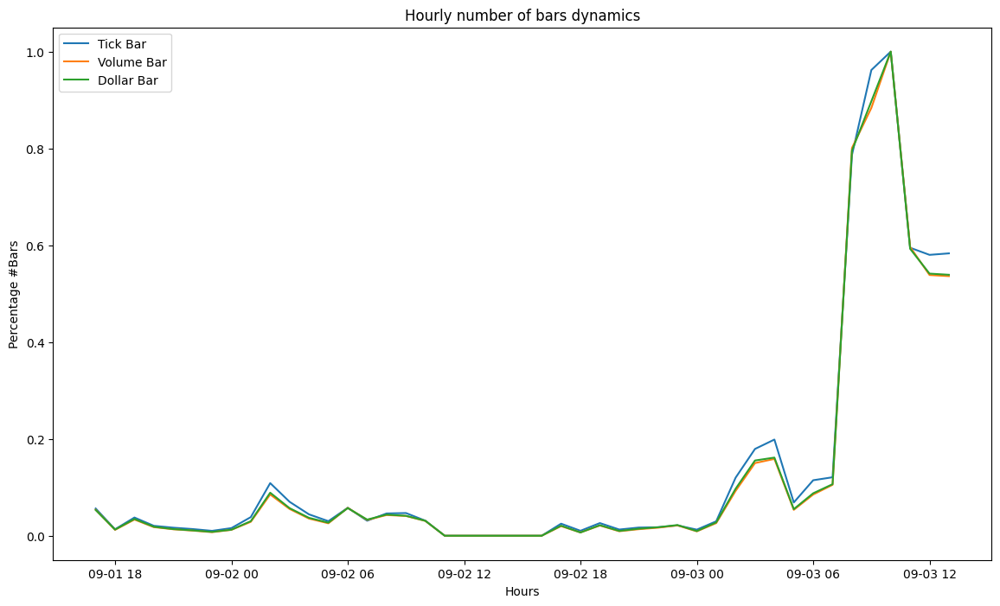

In [5]:
import numpy as np
import pandas as pd
from typing import Tuple
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

def get_num_week_bars(bars: pd.DataFrame) -> Tuple[np.ndarray, np.ndarray]:
    df = bars
    df['date_time'] = pd.to_datetime(df['date_time'])
    df = df.set_index('date_time')
    df = df.resample('h').count()
    weeks = df.index
    scaler = MinMaxScaler()
    num_bars_scaled = scaler.fit_transform(df)[:, 0]
    return weeks, num_bars_scaled

fig = plt.figure(figsize=(14, 8))
for bars, name in [(tick_bar, 'Tick Bar'), (volume_bar, 'Volume Bar'), (dollar_bar, 'Dollar Bar')]:
    weeks, num_bars = get_num_week_bars(bars)
    plt.plot(weeks, num_bars, label=name)
plt.xlabel('Hours')
plt.ylabel('Percentage #Bars')
plt.title('Hourly number of bars dynamics')
plt.legend()
plt.show()

### 3. Apply CumSum filter

We can apply the CumSum filter to find the selected timestamps using the `filters` module. We will use the dollar bar as an example.

In [26]:
t_events = qf.filters.cusum_filter(dollar_bar.set_index('date_time').close, threshold=0.005)
chosen_bars_df = pd.DataFrame(dollar_bar).set_index('date_time').loc[t_events, :]
fig = go.Figure(
    go.Scatter(x=dollar_bar.date_time, y=dollar_bar.close, line=dict(color="blue", width=1), name='Close Price')
).update_layout(xaxis_title="Time", yaxis_title="Price", title="Close Price and Selected Timestamps")
fig.add_trace(go.Scatter(
    x=chosen_bars_df.index, y=chosen_bars_df.close, mode='markers', marker=dict(size=3), name='Selected Timestamps'
    )
)
fig.show()